### Running inference on your own frames

Before running this notebook you should have already installed the environment by running the setup_videoknet_v2.sh

Before running this notebook you should have already created a folder named "frames" in the main directory and  have inserted the frames named and ordered according to the following convention: 

each image should have a filename beginning with 000002_. After that there must be an id identifying the number of the frame in format 60d. The filename should then with _leftImg8bit.png. So for example, if you have 10 frames, the first one should be named 000002_000001_leftImg8bit.png, the second one should be 000002_000002_leftImg8bit.png, the third 000002_000003_leftImg8bit.png and so on...



In [2]:
### Preparing folders

import os

folders = ['weights', 'data/inference_folder/video_sequence/val', 'model_inference_outputs', "frames", "video"]

for folder in folders:
    if not os.path.exists(folder):
        os.makedirs(folder)


In [3]:
!pip install gdown
!pip install opencv-python
!pip install matplotlib
!pip install tdqm


[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: python -m pip install --upgrade pip

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: python -m pip install --upgrade pip

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: python -m pip install --upgrade pip

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: python -m pip install --upgrade pip


#### Downloading the weights

This cell downloads the weights we trained on kitti-step (starting from a checkpoint pre-trained on cityscapes, taken from the authors).

In [4]:
import gdown
# uncomment this (and comment the other lines) if you want to use the authors' weights
# out = "./weights/knet_city_step_pan_r50.pth"
# url = "https://drive.google.com/file/d/1KKEjRcWoWyt_RC7bXAHiKqccABGIrO0V/view?usp=share_link"

out = "./weights/latest.pth"
url = "https://drive.google.com/file/d/1a2ULwN4bWDZ8z9qPtRFQJS2iq0u2y76q/view?usp=sharing"
gdown.download(url, out, quiet=False, fuzzy=True)

Downloading...
From (uriginal): https://drive.google.com/uc?id=1a2ULwN4bWDZ8z9qPtRFQJS2iq0u2y76q
From (redirected): https://drive.google.com/uc?id=1a2ULwN4bWDZ8z9qPtRFQJS2iq0u2y76q&confirm=t&uuid=c03bff65-c01b-4507-8ed8-c79493e23e49
To: /workspace/minini_clean_3/Video-K-Net/weights/latest.pth
100%|██████████| 478M/478M [00:18<00:00, 26.2MB/s] 


'./weights/latest.pth'

### Extracting frames from folder

In [5]:
!rm ./data/inference_folder/video_sequence/val/* #emptying the inference input folder

!cp ./frames/* ./data/inference_folder/video_sequence/val #copying the frames to the inference input folder 

!rm -r ./model_inference_outputs/* #cleaning the previous inference outputs, if theu exist

!bash ./tools/inference.sh configs/video_knet_kitti_step/video_knet_s3_r50_rpn_1x_kitti_step_sigmoid_stride2_mask_embed_link_ffn_joint_train.py ./weights/latest.pth ./model_inference_outputs prova_da_sh  #running the inference

rm: cannot remove './data/inference_folder/video_sequence/val/*': No such file or directory
rm: cannot remove './model_inference_outputs/*': No such file or directory
Namespace(cfg_options=None, checkpoint='./weights/latest.pth', config='configs/video_knet_kitti_step/video_knet_s3_r50_rpn_1x_kitti_step_sigmoid_stride2_mask_embed_link_ffn_joint_train.py', eval=None, eval_options=None, format_only=False, fuse_conv_bn=False, gpu_collect=False, launcher='none', local_rank=0, n_video=50, options=None, out=None, output_dir='./work_dirs/vps/vps_output', pan_im_json_file='data/cityscapes_vps/panoptic_im_val_city_vps.json', semantic=False, show=False, show_dir='./model_inference_outputs', show_score_thr=0.3, tmpdir=None)
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA {'type': 'KITTISTEPDVPSDataset', 'data_root': 'data/inference_folder', 'split': 'val', 'ref_seq_index': None, 'test_mode': True, 'pipeline': [{'type': 'LoadImgDirect'}, {'type': 'MultiScaleFlipAug', 'scale_f

#### Visualizing the results

The cells below are used to process the raw outputs of the model and to create some GIFs to visualize the results. For each raw output frame we save:

- the raw output for the frame
- the segmentation mask for the frame
- the instance mask for the frame
- the panoptic mask for the frame
- the original frame

We then create 5 gifs:

- the GIF of the segmentation mask
- the GIF of the instance mask
- the GIF of the panoptic mask
- the GIF of the original video
- the GIF of the original video with the panoptic mask in overlay

All of these files are saved in the folder named "outputs".


In [6]:
import hashlib
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import os
from PIL import Image
city_labels = [
    ('road', 0, (128, 64, 128)),
    ('sidewalk', 1, (244, 35, 232)),
    ('building', 2, (70, 70, 70)),
    ('wall', 3, (102, 102, 156)),
    ('fence', 4, (190, 153, 153)),
    ('pole', 5, (153, 153, 153)),
    ('traffic light', 6, (250, 170, 30)),
    ('traffic sign', 7, (220, 220, 0)),
    ('vegetation', 8, (107, 142, 35)),
    ('terrain', 9, (152, 251, 152)),
    ('sky', 10, (70, 130, 180)),
    ('person', 11, (220, 20, 60)),
    ('rider', 12, (255, 0, 0)),
    ('car', 13, (0, 0, 142)),
    ('truck', 14, (0, 0, 70)),
    ('bus', 15, (0, 60, 100)),
    ('train', 16, (0, 80, 100)),
    ('motorcycle', 17, (0, 0, 230)),
    ('bicycle', 18, (119, 11, 32)),
    ('void', 19, (0, 0, 0)),
    ('void', 255, (0, 0, 0))
]


def sha256num(num):
    hex = hashlib.sha256(str(num).encode('utf-8')).hexdigest()
    hex = hex[-6:]
    return int(hex, 16)


def id2rgb(id_map):
    if isinstance(id_map, np.ndarray):
        id_map_copy = id_map.copy()
        rgb_shape = tuple(list(id_map.shape) + [3])
        rgb_map = np.zeros(rgb_shape, dtype=np.uint8)
        for i in range(3):
            rgb_map[..., i] = id_map_copy % 256
            id_map_copy //= 256
        return rgb_map
    color = []
    for _ in range(3):
        color.append(id_map % 256)
        id_map //= 256
    return color


def cityscapes_cat2rgb(cat_map):
    color_map = np.zeros_like(cat_map).astype(np.uint8)
    color_map = color_map[..., None].repeat(3, axis=-1)
    for each_class in city_labels:
        index = cat_map == each_class[1]
        if index.any():
            color_map[index] = each_class[2]
    return color_map


def trackmap2rgb(track_map):
    color_map = np.zeros_like(track_map).astype(np.uint8)
    color_map = color_map[..., None].repeat(3, axis=-1)
    for id_cur in np.unique(track_map):
        if id_cur == 0:
            continue
        color_map[track_map == id_cur] = id2rgb(sha256num(id_cur))
    return color_map


def draw_bbox_on_img(vis_img, bboxes):
    for index in range(bboxes.shape[0]):
        cv2.rectangle(vis_img, (int(bboxes[index][0]), int(bboxes[index][1])),
                      (int(bboxes[index][2]), int(bboxes[index][3])), (0, 0, 255), thickness=1)
    return vis_img


In [ ]:
!rm ./outputs/results/*

In [7]:
#### TO PRODUCE THE GIF OF THE PANOPTIC MASKS OF THE MODEL (OUTPUTS)
from PIL import Image
import glob
import pathlib
MODEL_OUTPUT_PATH = "./model_inference_outputs"

def resize_img(image, basewidth = 600):
    img = image
    wpercent = (basewidth/float(img.size[0]))
    hsize = int((float(img.size[1])*float(wpercent)))
    img = img.resize((basewidth,hsize), Image.Resampling.LANCZOS)
    return img
absolute_count = 0

panoptic = []
semantic = []
instance = []
video = []
video_overlay = []

output_folder = "./outputs/results"
pathlib.Path(output_folder).mkdir(parents=True, exist_ok=True)

path_to_model_inputs = "/workspace/minini_clean_2/Video-K-Net/data/inference_folder/video_sequence/val/*left*"
path_to_model_outputs = f"{MODEL_OUTPUT_PATH}/final"
# path_to_model_outputs = "Video-K-Net/robertominini_predictions/final"
video_sequence_id = "0002"
PATH = os.path.join(path_to_model_outputs, video_sequence_id)

for file, video_image in zip(sorted(os.listdir(PATH)), sorted(glob.glob(path_to_model_inputs))):
    if not file[-4:] == ".png":
        continue
    # if absolute_count > 300:
    #     break
    image = Image.open(f"{path_to_model_outputs}/{video_sequence_id}/{file}")
    image_original = Image.open(video_image)
    
    # Load the images
    img1 = Image.fromarray(cityscapes_cat2rgb(np.array(image)[:, :, 0]))
    img2 = Image.fromarray(trackmap2rgb(np.array(image)[:, :, 2]))
    mask = Image.fromarray(np.array(image)[:, :, 2] == 0)

    # Compose image to add instance segmentation
    img_blend = Image.composite(img1, img2, mask)
    img_overlay = Image.blend(image_original, img_blend, 0.5)
    
    
    image.save(f"{output_folder}/raw_{absolute_count:06d}.png")
    img_blend.save(f"{output_folder}/panoptic_mask_{absolute_count:06d}.png")
    img1.save(f"{output_folder}/semantic_mask_{absolute_count:06d}.png")
    img2.save(f"{output_folder}/instance_mask_{absolute_count:06d}.png")
    image_original.save(f"{output_folder}/frame_{absolute_count:06d}.png")
    img_overlay.save(f"{output_folder}/video_overlay_{absolute_count:06d}.png")
    
    panoptic.append(resize_img(img_blend))
    semantic.append(resize_img(img1))
    instance.append(resize_img(img2))
    video.append(resize_img(image_original))
    video_overlay.append(resize_img(img_overlay))
    
    absolute_count += 1
    
durations = [0] * len(panoptic)
panoptic[0].save(f'{output_folder}/result_panoptic.gif',
               save_all=True, append_images=panoptic[1:], optimize=False, duration=durations, loop=0)
semantic[0].save(f'{output_folder}/result_semantic.gif',
               save_all=True, append_images=semantic[1:], optimize=False, duration=durations, loop=0)
instance[0].save(f'{output_folder}/result_instance.gif',
               save_all=True, append_images=instance[1:], optimize=False, duration=durations, loop=0)
video[0].save(f'{output_folder}/result_video.gif',
               save_all=True, append_images=video[1:], optimize=False, duration=durations, loop=0)
video_overlay[0].save(f'{output_folder}/result_video_overlay.gif',
               save_all=True, append_images=video_overlay[1:], optimize=False, duration=durations, loop=0)

print("Done!")

Done!


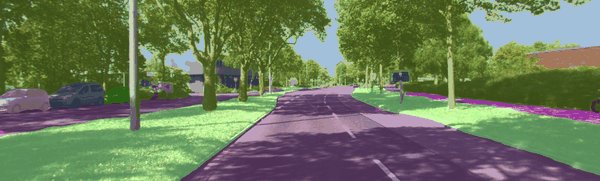

In [11]:
from IPython.display import Image
from IPython.display import display

#Uncomment to visualize!
# display(Image(f"{output_folder}/result_panoptic.gif"))
# display(Image(f"{output_folder}/result_semantic.gif"))
# display(Image(f"{output_folder}/result_instance.gif"))
# display(Image(f"{output_folder}/result_video.gif"))
display(Image(f"{output_folder}/result_video_overlay.gif"))

# Inference on DLAV test videos

This is the code that we used to run inference on the DLAV test frames. We do not expect you to need to run thsi code but we provide it nonetheless.

In [18]:
import os
MODEL_OUTPUT_PATH = "./model_inference_outputs"
os.environ["MODEL_OUTPUT_PATH"] = MODEL_OUTPUT_PATH

In [33]:
import gdown
import pathlib

test_number = 4

outdir = f"./tests/test{test_number}"
out = f"{outdir}/test{test_number}.zip"
url = "https://drive.google.com/file/d/1T1njkM2-fbqRdrOuo6pIL99LWMMhArrC/view?usp=share_link"
url = "https://drive.google.com/file/d/1-QGu8v6KT3R7Xc507PKUNPYq1EuocbIt/view?usp=share_link"
url = "https://drive.google.com/file/d/1GrRatuJeFAp_RkwLIJ_74p0mQmivD94n/view?usp=share_link"
pathlib.Path(outdir).mkdir(parents=True, exist_ok=True)

if not pathlib.Path(out).exists():
    gdown.download(url, out, quiet=False, fuzzy=True)
else:
    print("file already downloaded")

Downloading...
From (uriginal): https://drive.google.com/uc?id=1GrRatuJeFAp_RkwLIJ_74p0mQmivD94n
From (redirected): https://drive.google.com/uc?id=1GrRatuJeFAp_RkwLIJ_74p0mQmivD94n&confirm=t&uuid=953e3ead-978f-4f76-8362-90f968e99ec0
To: /workspace/minini_clean_2/Video-K-Net/tests/test4/test4.zip

  0%|          | 0.00/1.32G [00:00<?, ?B/s]
  0%|          | 1.05M/1.32G [00:00<02:08, 10.3MB/s]
  0%|          | 4.72M/1.32G [00:00<01:02, 21.0MB/s]
  1%|          | 11.0M/1.32G [00:00<00:35, 37.4MB/s]
  1%|          | 15.2M/1.32G [00:00<00:55, 23.5MB/s]
  1%|▏         | 18.9M/1.32G [00:00<01:01, 21.2MB/s]
  2%|▏         | 26.7M/1.32G [00:01<00:44, 29.2MB/s]
  3%|▎         | 34.1M/1.32G [00:01<00:43, 29.7MB/s]
  3%|▎         | 42.5M/1.32G [00:01<00:38, 33.6MB/s]
  4%|▍         | 50.3M/1.32G [00:01<00:30, 41.2MB/s]
  4%|▍         | 55.1M/1.32G [00:01<00:32, 38.9MB/s]
  5%|▍         | 59.8M/1.32G [00:01<00:33, 37.9MB/s]
  5%|▌         | 67.6M/1.32G [00:02<00:34, 35.9MB/s]
  6%|▌         | 76.0M

In [34]:
import zipfile
zipfile.ZipFile(out).extractall(path=outdir)

In [35]:
folder = "jpg" if pathlib.Path(f"{outdir}/jpg").exists() else "png"
os.environ["VIDEOKNET_TESTS_DIR"] = f"{outdir}/{folder}"
folder

'png'

In [40]:
import glob
for img in glob.glob(f"{outdir}/{folder}/*"):
    img = pathlib.Path(img)
    
    image_num = int(img.name.split(".")[0].split("_")[1])
    base_path = img.parent
    
    img.rename(f"{base_path}/000002_{image_num-1:06d}_leftImg8bit.png")

In [41]:
!rm ./data/inference_folder/video_sequence/val/*
!cp $VIDEOKNET_TESTS_DIR/* ./data/inference_folder/video_sequence/val

In [42]:
os.environ["MODEL_OUTPUT_PATH"] = MODEL_OUTPUT_PATH
# !rm -r $MODEL_OUTPUT_PATH/* #we empty the prediction folder
!rm -r ./model_inference_outputs/*
!bash ./tools/inference.sh configs/video_knet_kitti_step/video_knet_s3_r50_rpn_1x_kitti_step_sigmoid_stride2_mask_embed_link_ffn_joint_train.py ./weights/latest.pth ./$MODEL_OUTPUT_PATH prova_da_sh  #running the inference

Namespace(cfg_options=None, checkpoint='./weights/latest.pth', config='configs/video_knet_kitti_step/video_knet_s3_r50_rpn_1x_kitti_step_sigmoid_stride2_mask_embed_link_ffn_joint_train.py', eval=None, eval_options=None, format_only=False, fuse_conv_bn=False, gpu_collect=False, launcher='none', local_rank=0, n_video=50, options=None, out=None, output_dir='./work_dirs/vps/vps_output', pan_im_json_file='data/cityscapes_vps/panoptic_im_val_city_vps.json', semantic=False, show=False, show_dir='././model_inference_outputs', show_score_thr=0.3, tmpdir=None)
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA {'type': 'KITTISTEPDVPSDataset', 'data_root': 'data/inference_folder', 'split': 'val', 'ref_seq_index': None, 'test_mode': True, 'pipeline': [{'type': 'LoadImgDirect'}, {'type': 'MultiScaleFlipAug', 'scale_factor': [1.0], 'flip': False, 'transforms': [{'type': 'RandomFlip'}, {'type': 'Normalize', 'mean': [123.675, 116.28, 103.53], 'std': [58.395, 57.12, 57.375], 'to_rgb

In [ ]:
#### TO PRODUCE THE GIF OF THE PANOPTIC MASKS OF THE MODEL (OUTPUTS)
from PIL import Image
import glob
import pathlib
from tqdm.auto import tqdm

def resize_img(image, basewidth = 600):
    img = image
    wpercent = (basewidth/float(img.size[0]))
    hsize = int((float(img.size[1])*float(wpercent)))
    img = img.resize((basewidth,hsize), Image.Resampling.LANCZOS)
    return img
absolute_count = 0

panoptic = []
semantic = []
instance = []
video = []
video_overlay = []

output_folder = f"./outputs/test{test_number}"
pathlib.Path(output_folder).mkdir(parents=True, exist_ok=True)

path_to_model_inputs = "/workspace/minini_clean_2/Video-K-Net/data/inference_folder/video_sequence/val/*left*"
path_to_model_outputs = f"{MODEL_OUTPUT_PATH}/final"
# path_to_model_outputs = "Video-K-Net/robertominini_predictions/final"
video_sequence_id = "0002"
PATH = os.path.join(path_to_model_outputs, video_sequence_id)

with tqdm(initial=0, total=len(glob.glob("./data/inference_folder/video_sequence/val/*"))) as pbar:
    for file, video_image in zip(sorted(os.listdir(PATH)), sorted(glob.glob(path_to_model_inputs))):
        if not file[-4:] == ".png":
            continue
        # if absolute_count > 300:
        #     break
        image = Image.open(f"{path_to_model_outputs}/{video_sequence_id}/{file}")
        image_original = Image.open(video_image)

        # Load the images
        img1 = Image.fromarray(cityscapes_cat2rgb(np.array(image)[:, :, 0]))
        img2 = Image.fromarray(trackmap2rgb(np.array(image)[:, :, 2]))
        mask = Image.fromarray(np.array(image)[:, :, 2] == 0)

        # Compose image to add instance segmentation
        img_blend = Image.composite(img1, img2, mask)
        img_overlay = Image.blend(image_original, img_blend, 0.5)


        image.save(f"{output_folder}/raw_{absolute_count:06d}.png")
        img_blend.save(f"{output_folder}/panoptic_mask_{absolute_count:06d}.png")
        img1.save(f"{output_folder}/semantic_mask_{absolute_count:06d}.png")
        img2.save(f"{output_folder}/instance_mask_{absolute_count:06d}.png")
        image_original.save(f"{output_folder}/frame_{absolute_count:06d}.png")
        img_overlay.save(f"{output_folder}/video_overlay_{absolute_count:06d}.png")

        panoptic.append(resize_img(img_blend))
        semantic.append(resize_img(img1))
        instance.append(resize_img(img2))
        video.append(resize_img(image_original))
        video_overlay.append(resize_img(img_overlay))

        absolute_count += 1
        pbar.update(1)
    
durations = [0] * len(panoptic)
panoptic[0].save(f'{output_folder}/result_panoptic.gif',
               save_all=True, append_images=panoptic[1:], optimize=False, duration=durations, loop=0)
semantic[0].save(f'{output_folder}/result_semantic.gif',
               save_all=True, append_images=semantic[1:], optimize=False, duration=durations, loop=0)
instance[0].save(f'{output_folder}/result_instance.gif',
               save_all=True, append_images=instance[1:], optimize=False, duration=durations, loop=0)
video[0].save(f'{output_folder}/result_video.gif',
               save_all=True, append_images=video[1:], optimize=False, duration=durations, loop=0)
video_overlay[0].save(f'{output_folder}/result_video_overlay.gif',
               save_all=True, append_images=video_overlay[1:], optimize=False, duration=durations, loop=0)

print("Done!")

  0%|          | 0/1153 [00:00<?, ?it/s]